# 1. Install packages

In [1]:
import pandas as pd
import numpy as np
import yfinance as yf
import hvplot.pandas
import seaborn as sns
import matplotlib.pyplot as plt

# 2. Set up the Global Parameters

In [2]:
# Fetch full stocks information from csv, which is downloaded from https://www.nasdaq.com/market-activity/stocks/screener

full_stocks = pd.read_csv('stocks_list.csv')
full_stocks

,Symbol,Name,Last Sale,Net Change,% Change,Market Cap,Country,IPO Year,Volume,Sector,Industry
0,A,Agilent Technologies Inc. Common Stock,$132.82,-0.1500,-0.113%,3.891680e+10,United States,1999.0,2374506,Industrials,Electrical Products
1,AA,Alcoa Corporation Common Stock,$26.84,-2.6500,-8.986%,4.790186e+09,United States,2016.0,8815965,Industrials,Aluminum
2,AACG,ATA Creativity Global American Depositary Shares,$1.08,0.0000,0.00%,3.415194e+07,China,2008.0,2116,Real Estate,Other Consumer Services
3,AACI,Armada Acquisition Corp. I Common Stock,$10.9101,-0.0099,-0.091%,0.000000e+00,United States,2021.0,7822,Finance,Blank Checks
4,AACIU,Armada Acquisition Corp. I Unit,$10.90,0.0100,0.092%,0.000000e+00,United States,2021.0,1655,Finance,Blank Checks
...,...,...,...,...,...,...,...,...,...,...,...
7277,ZVRA,Zevra Therapeutics Inc. Common Stock,$5.77,-0.0100,-0.173%,2.089788e+08,United States,NaN,145712,Health Care,Biotechnology: Pharmaceutical Preparations
7278,ZVSA,ZyVersa Therapeutics Inc. Common Stock,$0.61,0.0258,4.416%,7.584110e+05,United States,2022.0,144276,Health Care,Biotechnology: Pharmaceutical Preparations
7279,ZWS,Zurn Elkay Water Solutions Corporation Common ...,$31.19,0.3300,1.069%,5.389961e+09,United States,2012.0,2445706,Industrials,Industrial Machinery/Components
7280,ZYME,Zymeworks Inc. Common Stock,$10.95,-0.0500,-0.455%,7.665218e+08,United States,NaN,306937,Health Care,Biotechnology: Pharmaceutical Preparations


In [3]:
# Check the data

full_stocks.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7282 entries, 0 to 7281
Data columns (total 11 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Symbol      7281 non-null   object 
 1   Name        7282 non-null   object 
 2   Last Sale   7282 non-null   object 
 3   Net Change  7282 non-null   float64
 4   % Change    7281 non-null   object 
 5   Market Cap  6857 non-null   float64
 6   Country     6978 non-null   object 
 7   IPO Year    4156 non-null   float64
 8   Volume      7282 non-null   int64  
 9   Sector      6511 non-null   object 
 10  Industry    6511 non-null   object 
dtypes: float64(3), int64(1), object(7)
memory usage: 625.9+ KB


In [4]:
# There is only 1 NaN in the Symbol column

full_stocks.isnull().sum()

Symbol           1
Name             0
Last Sale        0
Net Change       0
% Change         1
Market Cap     425
Country        304
IPO Year      3126
Volume           0
Sector         771
Industry       771
dtype: int64

In [5]:
# Filter out stocks as Market Cap greater than 1 billion, and Volumn greater than 1 million

filter_stocks = full_stocks[(full_stocks['Market Cap'] > 1000000000) & (full_stocks['Volume'] > 1000000)]
filter_stocks

,Symbol,Name,Last Sale,Net Change,% Change,Market Cap,Country,IPO Year,Volume,Sector,Industry
0,A,Agilent Technologies Inc. Common Stock,$132.82,-0.15,-0.113%,3.891680e+10,United States,1999.0,2374506,Industrials,Electrical Products
1,AA,Alcoa Corporation Common Stock,$26.84,-2.65,-8.986%,4.790186e+09,United States,2016.0,8815965,Industrials,Aluminum
10,AAL,American Airlines Group Inc. Common Stock,$14.26,-0.30,-2.06%,9.319503e+09,United States,NaN,25279592,Consumer Discretionary,Air Freight/Delivery Services
16,AAP,Advance Auto Parts Inc.,$65.13,-2.66,-3.924%,3.875365e+09,United States,NaN,1543543,Consumer Discretionary,Auto & Home Supply Stores
17,AAPL,Apple Inc. Common Stock,$187.68,1.83,0.985%,2.898132e+12,United States,1980.0,69573260,Technology,Computer Manufacturing
...,...,...,...,...,...,...,...,...,...,...,...
7268,ZS,Zscaler Inc. Common Stock,$232.05,-11.95,-4.898%,3.442078e+10,United States,2018.0,4759249,Technology,EDP Services
7270,ZTO,ZTO Express (Cayman) Inc. American Depositary ...,$16.59,0.51,3.172%,1.352536e+10,China,2016.0,4329403,Industrials,Trucking Freight/Courier Services
7272,ZTS,Zoetis Inc. Class A Common Stock,$190.17,1.13,0.598%,8.730965e+10,United States,2013.0,2112456,Health Care,Biotechnology: Pharmaceutical Preparations
7274,ZUO,Zuora Inc. Class A Common Stock,$8.61,-0.17,-1.936%,1.232091e+09,United States,2018.0,1038026,Technology,EDP Services


In [6]:
# Check the filtered data again

filter_stocks.isnull().sum()

Symbol          0
Name            0
Last Sale       0
Net Change      0
% Change        0
Market Cap      0
Country        15
IPO Year      539
Volume          0
Sector         35
Industry       35
dtype: int64

In [7]:
# Get tickers from the DataFrame, and make sure all the data type are string

assets = [str(symbol) for symbol in filter_stocks['Symbol'].tolist()]
assets.sort()

# for hourly data, yfinance policy restricts the time frame within 730 days
start_date = '2022-01-01'
end_date = '2023-12-31'

# 3. Data Exploration

## 3.1 Data Collection and Reframe

In [8]:
# Fetch stocks historical daily data from yfinance
stocks_daily = yf.download(assets, start = start_date, end = end_date, interval = '1D', auto_adjust = True)

[*******************   39%%                      ]  414 of 1075 completedFailed to get ticker 'BRK/B' reason: Expecting value: line 1 column 1 (char 0)
[*********************100%%**********************]  1075 of 1075 completed

4 Failed downloads:
['BRK/B', 'SAND          ']: Exception('%ticker%: No timezone found, symbol may be delisted')
['CORZ', 'BTSG']: Exception("%ticker%: Data doesn't exist for startDate = 1641013200, endDate = 1703998800")


In [9]:
# Fetch Bitcoin historical daily data from yfinance
btc_daily = yf.download('BTC-USD', start = start_date, end = end_date, interval = '1D', auto_adjust = True)

[*********************100%%**********************]  1 of 1 completed


In [10]:
# Check stocks data

stocks_daily

Price      Adj Close                                Close             \
Ticker         BRK/B BTSG CORZ SAND                     A         AA   
Date                                                                   
2022-01-03       NaN  NaN  NaN            NaN  154.335785  59.210793   
2022-01-04       NaN  NaN  NaN            NaN  149.118271  56.434666   
2022-01-05       NaN  NaN  NaN            NaN  146.563782  57.435249   
2022-01-06       NaN  NaN  NaN            NaN  147.076630  57.337154   
2022-01-07       NaN  NaN  NaN            NaN  143.161041  61.182518   
...              ...  ...  ...            ...         ...        ...   
2023-12-22       NaN  NaN  NaN            NaN  139.334351  33.770000   
2023-12-26       NaN  NaN  NaN            NaN  139.573929  33.869999   
2023-12-27       NaN  NaN  NaN            NaN  139.583923  34.810001   
2023-12-28       NaN  NaN  NaN            NaN  139.534012  34.549999   
2023-12-29       NaN  NaN  NaN            NaN  139.029999  34.000000   

Price                                                      ...   Volume  \
Ticker            AAL         AAP        AAPL        ABBV  ...      ZBH   
Date                                                       ...            
2022-01-03  18.750000  222.913803  179.953888  124.095062  ...  1184809   
2022-01-04  19.020000  223.167984  177.669983  123.856812  ...  1400800   
2022-01-05  18.680000  222.603134  172.944000  124.507423  ...  1895715   
2022-01-06  18.570000  227.498611  170.056961  123.920959  ...  1088813   
2022-01-07  19.280001  224.147079  170.225037  123.600212  ...  1690230   
...               ...         ...         ...         ...  ...      ...   
2023-12-22  14.310000   60.998890  193.600006  153.473663  ...  1337800   
2023-12-26  14.110000   60.670242  193.050003  153.156693  ...  1870700   
2023-12-27  13.990000   61.307621  193.149994  153.414230  ...  1058600   
2023-12-28  13.980000   61.237911  193.580002  153.285461  ...   662200   
2023-12-29  13.740000   60.779793  192.529999  153.503372  ...   849600   

Price                                                                       \
Ticker           ZI       ZIM     ZION       ZM       ZS      ZTO      ZTS   
Date                                                                         
2022-01-03  2981100   3252400  1218000  3171900  2576000  3115800  2772700   
2022-01-04  7462800   2329900  1355900  5269800  3827700  3133500  4664000   
2022-01-05  4179500   3061100  1113800  3772300  3437700  1435600  4749400   
2022-01-06  3191200   2119200  1439600  4002500  2439600  1420200  3103400   
2022-01-07  3363200   2238800  1289200  3089400  1696000  3126800  2206500   
...             ...       ...      ...      ...      ...      ...      ...   
2023-12-22  3096400  11950800  1534500  2383600   912600  1735900  1548400   
2023-12-26  2262500  17195100  1131600  2939900   770000  1548900   814600   
2023-12-27  3330600   7832600  1345100  2392300   840800  1606500   766400   
2023-12-28  2348300   5333900  1125900  2330200   575300  3361800   880100   
2023-12-29  2619600   5924500  1420600  2425900   804800  2938400  1007200   

Price                         
Ticker          ZUO      ZWS  
Date                          
2022-01-03  1308300   577400  
2022-01-04  1567000   422700  
2022-01-05  1151100   461100  
2022-01-06  1479200   453400  
2022-01-07  1970100   652000  
...             ...      ...  
2023-12-22   604300  1023400  
2023-12-26   547600   573500  
2023-12-27   922000   987000  
2023-12-28   835000   924500  
2023-12-29   855900   754000  

[501 rows x 5379 columns]

In [11]:
#Check if there is NULL in the data
stocks_daily.isnull().sum()

Price      Ticker        
Adj Close  BRK/B             501
           BTSG              501
           CORZ              501
           SAND              501
Close      A                   0
                            ... 
Volume     ZS                  0
           ZTO                 0
           ZTS                 0
           ZUO                 0
           ZWS                 0
Length: 5379, dtype: int64

In [12]:
# Drop the non-useful information and check again

stocks_daily.drop(columns = 'Adj Close', inplace = True)
stocks_daily

Price            Close                                                \
Ticker               A         AA        AAL         AAP        AAPL   
Date                                                                   
2022-01-03  154.335785  59.210793  18.750000  222.913803  179.953888   
2022-01-04  149.118271  56.434666  19.020000  223.167984  177.669983   
2022-01-05  146.563782  57.435249  18.680000  222.603134  172.944000   
2022-01-06  147.076630  57.337154  18.570000  227.498611  170.056961   
2022-01-07  143.161041  61.182518  19.280001  224.147079  170.225037   
...                ...        ...        ...         ...         ...   
2023-12-22  139.334351  33.770000  14.310000   60.998890  193.600006   
2023-12-26  139.573929  33.869999  14.110000   60.670242  193.050003   
2023-12-27  139.583923  34.810001  13.990000   61.307621  193.149994   
2023-12-28  139.534012  34.549999  13.980000   61.237911  193.580002   
2023-12-29  139.029999  34.000000  13.740000   60.779793  192.529999   

Price                                                           ...   Volume  \
Ticker            ABBV   ABCL      ABEV        ABNB        ABR  ...      ZBH   
Date                                                            ...            
2022-01-03  124.095062  14.14  2.450743  172.679993  14.978005  ...  1184809   
2022-01-04  123.856812  13.27  2.441733  170.800003  15.098858  ...  1400800   
2022-01-05  124.507423  12.26  2.369652  162.250000  14.865206  ...  1895715   
2022-01-06  123.920959  12.09  2.342622  159.750000  15.034404  ...  1088813   
2022-01-07  123.600212  11.82  2.333612  166.050003  15.098858  ...  1690230   
...                ...    ...       ...         ...        ...  ...      ...   
2023-12-22  153.473663   5.69  2.810000  140.800003  15.760000  ...  1337800   
2023-12-26  153.156693   5.77  2.830000  138.720001  16.170000  ...  1870700   
2023-12-27  153.414230   5.80  2.840000  136.550003  16.090000  ...  1058600   
2023-12-28  153.285461   5.93  2.820000  137.000000  15.810000  ...   662200   
2023-12-29  153.503372   5.71  2.800000  136.139999  15.180000  ...   849600   

Price                                                                       \
Ticker           ZI       ZIM     ZION       ZM       ZS      ZTO      ZTS   
Date                                                                         
2022-01-03  2981100   3252400  1218000  3171900  2576000  3115800  2772700   
2022-01-04  7462800   2329900  1355900  5269800  3827700  3133500  4664000   
2022-01-05  4179500   3061100  1113800  3772300  3437700  1435600  4749400   
2022-01-06  3191200   2119200  1439600  4002500  2439600  1420200  3103400   
2022-01-07  3363200   2238800  1289200  3089400  1696000  3126800  2206500   
...             ...       ...      ...      ...      ...      ...      ...   
2023-12-22  3096400  11950800  1534500  2383600   912600  1735900  1548400   
2023-12-26  2262500  17195100  1131600  2939900   770000  1548900   814600   
2023-12-27  3330600   7832600  1345100  2392300   840800  1606500   766400   
2023-12-28  2348300   5333900  1125900  2330200   575300  3361800   880100   
2023-12-29  2619600   5924500  1420600  2425900   804800  2938400  1007200   

Price                         
Ticker          ZUO      ZWS  
Date                          
2022-01-03  1308300   577400  
2022-01-04  1567000   422700  
2022-01-05  1151100   461100  
2022-01-06  1479200   453400  
2022-01-07  1970100   652000  
...             ...      ...  
2023-12-22   604300  1023400  
2023-12-26   547600   573500  
2023-12-27   922000   987000  
2023-12-28   835000   924500  
2023-12-29   855900   754000  

[501 rows x 5375 columns]

In [13]:
#Extract only the "Close" price data
stocks_close = stocks_daily['Close']
stocks_close

Ticker,A,AA,AAL,AAP,AAPL,ABBV,ABCL,ABEV,ABNB,ABR,...,ZBH,ZI,ZIM,ZION,ZM,ZS,ZTO,ZTS,ZUO,ZWS
Date,,,,,,,,,,,,,,,,,,,,,
2022-01-03,154.335785,59.210793,18.750000,222.913803,179.953888,124.095062,14.14,2.450743,172.679993,14.978005,...,123.374710,61.459999,25.489300,59.537769,184.259995,301.829987,27.044531,229.704391,18.350000,35.599037
2022-01-04,149.118271,56.434666,19.020000,223.167984,177.669983,123.856812,13.27,2.441733,170.800003,15.098858,...,124.626320,58.810001,25.354580,61.233810,179.850006,281.579987,27.132498,220.959045,17.990000,36.305908
2022-01-05,146.563782,57.435249,18.680000,222.603134,172.944000,124.507423,12.26,2.369652,162.250000,14.865206,...,124.215485,54.320000,24.528284,61.372829,174.880005,262.329987,27.230238,212.557251,16.770000,35.000164
2022-01-06,147.076630,57.337154,18.570000,227.498611,170.056961,123.920959,12.09,2.342622,159.750000,15.034404,...,123.183609,54.389999,25.026754,63.893738,176.330002,260.209991,27.376846,213.401367,16.530001,34.852890
2022-01-07,143.161041,61.182518,19.280001,224.147079,170.225037,123.600212,11.82,2.333612,166.050003,15.098858,...,122.438377,52.500000,25.408464,64.959564,171.600006,261.529999,27.494133,207.188370,16.530001,34.038013
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-12-22,139.334351,33.770000,14.310000,60.998890,193.600006,153.473663,5.69,2.810000,140.800003,15.760000,...,120.319992,18.680000,11.580000,44.000000,72.500000,221.679993,19.840000,194.538773,9.340000,29.940001
2023-12-26,139.573929,33.869999,14.110000,60.670242,193.050003,153.156693,5.77,2.830000,138.720001,16.170000,...,121.419998,18.930000,10.250000,44.880001,74.209999,224.589996,20.170000,195.057587,9.450000,30.160000
2023-12-27,139.583923,34.810001,13.990000,61.307621,193.149994,153.414230,5.80,2.840000,136.550003,16.090000,...,121.129997,18.809999,10.120000,44.509998,73.730003,225.020004,20.070000,196.454422,9.550000,29.930000


In [14]:
# When fetching the data from yfinance, there is a hint warning some tickers are not loaded, so drop them all.
stocks_close.dropna(axis = 'columns', how = 'all', inplace = True)
stocks_close

C:\Users\yjmal\AppData\Local\Temp\ipykernel_57736\4219715668.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  stocks_close.dropna(axis = 'columns', how = 'all', inplace = True)


Ticker,A,AA,AAL,AAP,AAPL,ABBV,ABCL,ABEV,ABNB,ABR,...,ZBH,ZI,ZIM,ZION,ZM,ZS,ZTO,ZTS,ZUO,ZWS
Date,,,,,,,,,,,,,,,,,,,,,
2022-01-03,154.335785,59.210793,18.750000,222.913803,179.953888,124.095062,14.14,2.450743,172.679993,14.978005,...,123.374710,61.459999,25.489300,59.537769,184.259995,301.829987,27.044531,229.704391,18.350000,35.599037
2022-01-04,149.118271,56.434666,19.020000,223.167984,177.669983,123.856812,13.27,2.441733,170.800003,15.098858,...,124.626320,58.810001,25.354580,61.233810,179.850006,281.579987,27.132498,220.959045,17.990000,36.305908
2022-01-05,146.563782,57.435249,18.680000,222.603134,172.944000,124.507423,12.26,2.369652,162.250000,14.865206,...,124.215485,54.320000,24.528284,61.372829,174.880005,262.329987,27.230238,212.557251,16.770000,35.000164
2022-01-06,147.076630,57.337154,18.570000,227.498611,170.056961,123.920959,12.09,2.342622,159.750000,15.034404,...,123.183609,54.389999,25.026754,63.893738,176.330002,260.209991,27.376846,213.401367,16.530001,34.852890
2022-01-07,143.161041,61.182518,19.280001,224.147079,170.225037,123.600212,11.82,2.333612,166.050003,15.098858,...,122.438377,52.500000,25.408464,64.959564,171.600006,261.529999,27.494133,207.188370,16.530001,34.038013
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-12-22,139.334351,33.770000,14.310000,60.998890,193.600006,153.473663,5.69,2.810000,140.800003,15.760000,...,120.319992,18.680000,11.580000,44.000000,72.500000,221.679993,19.840000,194.538773,9.340000,29.940001
2023-12-26,139.573929,33.869999,14.110000,60.670242,193.050003,153.156693,5.77,2.830000,138.720001,16.170000,...,121.419998,18.930000,10.250000,44.880001,74.209999,224.589996,20.170000,195.057587,9.450000,30.160000
2023-12-27,139.583923,34.810001,13.990000,61.307621,193.149994,153.414230,5.80,2.840000,136.550003,16.090000,...,121.129997,18.809999,10.120000,44.509998,73.730003,225.020004,20.070000,196.454422,9.550000,29.930000


In [15]:
# If dropna directly, will lose many data, that means some columns still have NaN 
stocks_close.dropna()

Ticker,A,AA,AAL,AAP,AAPL,ABBV,ABCL,ABEV,ABNB,ABR,...,ZBH,ZI,ZIM,ZION,ZM,ZS,ZTO,ZTS,ZUO,ZWS
Date,,,,,,,,,,,,,,,,,,,,,
2023-10-04,111.481445,27.044476,12.73,51.910843,173.431519,144.842484,4.43,2.421627,127.410004,13.129010,...,109.471642,16.750000,9.58,32.929260,66.059998,155.119995,23.790001,170.195572,7.98,27.166452
2023-10-05,110.163673,26.417154,12.85,52.485645,174.679871,144.607101,4.42,2.364647,124.989998,13.439068,...,109.082413,16.520000,9.32,32.998417,64.519997,153.300003,23.879999,171.200882,7.95,26.986938
2023-10-06,110.453186,27.034517,12.76,51.524334,177.256485,145.381882,4.42,2.412130,126.360001,13.254972,...,110.689209,16.930000,9.77,33.284927,65.480003,163.589996,24.610001,174.764252,7.96,26.388557
2023-10-09,111.092102,27.134092,12.24,50.899975,178.754501,146.235107,4.40,2.402634,127.769997,13.749125,...,110.469650,16.930000,9.77,33.561565,66.099998,168.860001,24.450001,173.788803,7.93,26.179125
2023-10-10,113.098717,28.080051,12.26,51.623440,178.155289,146.019348,4.52,2.469110,131.589996,14.020427,...,111.966660,17.170000,9.66,34.697735,67.279999,171.880005,24.629999,174.814011,7.98,26.737614
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-12-22,139.334351,33.770000,14.31,60.998890,193.600006,153.473663,5.69,2.810000,140.800003,15.760000,...,120.319992,18.680000,11.58,44.000000,72.500000,221.679993,19.840000,194.538773,9.34,29.940001
2023-12-26,139.573929,33.869999,14.11,60.670242,193.050003,153.156693,5.77,2.830000,138.720001,16.170000,...,121.419998,18.930000,10.25,44.880001,74.209999,224.589996,20.170000,195.057587,9.45,30.160000
2023-12-27,139.583923,34.810001,13.99,61.307621,193.149994,153.414230,5.80,2.840000,136.550003,16.090000,...,121.129997,18.809999,10.12,44.509998,73.730003,225.020004,20.070000,196.454422,9.55,29.930000


In [16]:
# Fill all the NaN

stocks_close.fillna(method = 'ffill', inplace = True)
stocks_close.fillna(0, inplace = True)

C:\Users\yjmal\AppData\Local\Temp\ipykernel_57736\4075513137.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  stocks_close.fillna(method = 'ffill', inplace = True)
C:\Users\yjmal\AppData\Local\Temp\ipykernel_57736\4075513137.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  stocks_close.fillna(0, inplace = True)


In [17]:
# Check again
stocks_close.dropna()

Ticker,A,AA,AAL,AAP,AAPL,ABBV,ABCL,ABEV,ABNB,ABR,...,ZBH,ZI,ZIM,ZION,ZM,ZS,ZTO,ZTS,ZUO,ZWS
Date,,,,,,,,,,,,,,,,,,,,,
2022-01-03,154.335785,59.210793,18.750000,222.913803,179.953888,124.095062,14.14,2.450743,172.679993,14.978005,...,123.374710,61.459999,25.489300,59.537769,184.259995,301.829987,27.044531,229.704391,18.350000,35.599037
2022-01-04,149.118271,56.434666,19.020000,223.167984,177.669983,123.856812,13.27,2.441733,170.800003,15.098858,...,124.626320,58.810001,25.354580,61.233810,179.850006,281.579987,27.132498,220.959045,17.990000,36.305908
2022-01-05,146.563782,57.435249,18.680000,222.603134,172.944000,124.507423,12.26,2.369652,162.250000,14.865206,...,124.215485,54.320000,24.528284,61.372829,174.880005,262.329987,27.230238,212.557251,16.770000,35.000164
2022-01-06,147.076630,57.337154,18.570000,227.498611,170.056961,123.920959,12.09,2.342622,159.750000,15.034404,...,123.183609,54.389999,25.026754,63.893738,176.330002,260.209991,27.376846,213.401367,16.530001,34.852890
2022-01-07,143.161041,61.182518,19.280001,224.147079,170.225037,123.600212,11.82,2.333612,166.050003,15.098858,...,122.438377,52.500000,25.408464,64.959564,171.600006,261.529999,27.494133,207.188370,16.530001,34.038013
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-12-22,139.334351,33.770000,14.310000,60.998890,193.600006,153.473663,5.69,2.810000,140.800003,15.760000,...,120.319992,18.680000,11.580000,44.000000,72.500000,221.679993,19.840000,194.538773,9.340000,29.940001
2023-12-26,139.573929,33.869999,14.110000,60.670242,193.050003,153.156693,5.77,2.830000,138.720001,16.170000,...,121.419998,18.930000,10.250000,44.880001,74.209999,224.589996,20.170000,195.057587,9.450000,30.160000
2023-12-27,139.583923,34.810001,13.990000,61.307621,193.149994,153.414230,5.80,2.840000,136.550003,16.090000,...,121.129997,18.809999,10.120000,44.509998,73.730003,225.020004,20.070000,196.454422,9.550000,29.930000


In [18]:
# Get the BTC close price data

btc_close = btc_daily['Close'].to_frame()
btc_close.columns = ['BTC']
btc_close

,BTC
Date,
2022-01-01,47686.812500
2022-01-02,47345.218750
2022-01-03,46458.117188
2022-01-04,45897.574219
2022-01-05,43569.003906
...,...
2023-12-26,42520.402344
2023-12-27,43442.855469
2023-12-28,42627.855469


In [19]:
# Combine stocks and BTC close price into one DataFrame

df_close = pd.concat([stocks_close, btc_close], axis = 1, join = 'inner')
df_close

,A,AA,AAL,AAP,AAPL,ABBV,ABCL,ABEV,ABNB,ABR,...,ZI,ZIM,ZION,ZM,ZS,ZTO,ZTS,ZUO,ZWS,BTC
Date,,,,,,,,,,,,,,,,,,,,,
2022-01-03,154.335785,59.210793,18.750000,222.913803,179.953888,124.095062,14.14,2.450743,172.679993,14.978005,...,61.459999,25.489300,59.537769,184.259995,301.829987,27.044531,229.704391,18.350000,35.599037,46458.117188
2022-01-04,149.118271,56.434666,19.020000,223.167984,177.669983,123.856812,13.27,2.441733,170.800003,15.098858,...,58.810001,25.354580,61.233810,179.850006,281.579987,27.132498,220.959045,17.990000,36.305908,45897.574219
2022-01-05,146.563782,57.435249,18.680000,222.603134,172.944000,124.507423,12.26,2.369652,162.250000,14.865206,...,54.320000,24.528284,61.372829,174.880005,262.329987,27.230238,212.557251,16.770000,35.000164,43569.003906
2022-01-06,147.076630,57.337154,18.570000,227.498611,170.056961,123.920959,12.09,2.342622,159.750000,15.034404,...,54.389999,25.026754,63.893738,176.330002,260.209991,27.376846,213.401367,16.530001,34.852890,43160.929688
2022-01-07,143.161041,61.182518,19.280001,224.147079,170.225037,123.600212,11.82,2.333612,166.050003,15.098858,...,52.500000,25.408464,64.959564,171.600006,261.529999,27.494133,207.188370,16.530001,34.038013,41557.902344
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-12-22,139.334351,33.770000,14.310000,60.998890,193.600006,153.473663,5.69,2.810000,140.800003,15.760000,...,18.680000,11.580000,44.000000,72.500000,221.679993,19.840000,194.538773,9.340000,29.940001,43997.902344
2023-12-26,139.573929,33.869999,14.110000,60.670242,193.050003,153.156693,5.77,2.830000,138.720001,16.170000,...,18.930000,10.250000,44.880001,74.209999,224.589996,20.170000,195.057587,9.450000,30.160000,42520.402344
2023-12-27,139.583923,34.810001,13.990000,61.307621,193.149994,153.414230,5.80,2.840000,136.550003,16.090000,...,18.809999,10.120000,44.509998,73.730003,225.020004,20.070000,196.454422,9.550000,29.930000,43442.855469


## 3.2 Correlation within all the assets

### 3.2.1 Regular Correlation Analysis

In [20]:
# Calculate daily returns for each asset, using log method
daily_returns = df_close.apply(np.log).diff(1).dropna(how = 'all')
daily_returns.fillna(0, inplace = True)
daily_returns

,A,AA,AAL,AAP,AAPL,ABBV,ABCL,ABEV,ABNB,ABR,...,ZI,ZIM,ZION,ZM,ZS,ZTO,ZTS,ZUO,ZWS,BTC
Date,,,,,,,,,,,,,,,,,,,,,
2022-01-04,-0.034391,-0.048020,0.014297,0.001140,-0.012773,-0.001922,-0.063502,-0.003683,-0.010947,0.008036,...,-0.044075,-0.005299,0.028089,-0.024225,-0.069447,0.003247,-0.038816,-0.019814,0.019662,-0.012139
2022-01-05,-0.017279,0.017575,-0.018038,-0.002534,-0.026960,0.005239,-0.079164,-0.029965,-0.051355,-0.015596,...,-0.079419,-0.033132,0.002268,-0.028023,-0.070813,0.003596,-0.038766,-0.070224,-0.036628,-0.052066
2022-01-06,0.003493,-0.001709,-0.005906,0.021754,-0.016834,-0.004721,-0.013963,-0.011472,-0.015528,0.011318,...,0.001288,0.020119,0.040254,0.008257,-0.008114,0.005370,0.003963,-0.014415,-0.004217,-0.009410
2022-01-07,-0.026984,0.064913,0.037521,-0.014842,0.000988,-0.002592,-0.022586,-0.003854,0.038679,0.004278,...,-0.035367,0.015137,0.016544,-0.027191,0.005060,0.004275,-0.029546,0.000000,-0.023658,-0.037848
2022-01-10,0.000069,-0.013397,-0.025743,-0.016772,0.000116,0.011133,0.005063,0.003854,-0.032687,-0.001068,...,0.013997,0.036102,-0.007591,0.005579,0.052583,0.039043,0.007128,-0.003636,-0.018045,0.006317
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-12-22,0.004524,0.053212,-0.002791,0.009185,-0.005563,0.015283,0.000000,0.013255,-0.009120,-0.016987,...,-0.013823,0.097904,0.008674,0.008310,0.001580,-0.008532,0.001643,0.018369,0.009733,0.002931
2023-12-26,0.001718,0.002957,-0.014075,-0.005402,-0.002845,-0.002067,0.013962,0.007092,-0.014883,0.025683,...,0.013295,-0.122002,0.019803,0.023312,0.013042,0.016496,0.002663,0.011708,0.007321,-0.034158
2023-12-27,0.000072,0.027375,-0.008541,0.010451,0.000518,0.001680,0.005186,0.003527,-0.015767,-0.004960,...,-0.006359,-0.012764,-0.008278,-0.006489,0.001913,-0.004970,0.007136,0.010526,-0.007655,0.021462


In [21]:
# Show daily returns plot
daily_returns.hvplot(xlabel = 'Date', ylabel = 'Daily Return', 
                     title = 'Daily Returns of Tickers', width = 900, height = 400)

:NdOverlay   [Variable]
   :Curve   [Date]   (value)

In [22]:
# Calculate the correlation matrix
correlation_matrix = daily_returns.corr()

# Display the correlation matrix
correlation_matrix

,A,AA,AAL,AAP,AAPL,ABBV,ABCL,ABEV,ABNB,ABR,...,ZI,ZIM,ZION,ZM,ZS,ZTO,ZTS,ZUO,ZWS,BTC
A,1.000000,0.383148,0.375374,0.293831,0.507935,0.233975,0.417226,0.233229,0.416655,0.384281,...,0.395779,0.259004,0.328372,0.403828,0.418381,0.252556,0.613680,0.390085,0.463566,0.274471
AA,0.383148,1.000000,0.339323,0.261323,0.348255,0.126455,0.285112,0.293936,0.420167,0.419008,...,0.335949,0.359262,0.382024,0.263588,0.312784,0.316655,0.337689,0.319174,0.343569,0.244581
AAL,0.375374,0.339323,1.000000,0.276847,0.501293,0.080302,0.369012,0.253582,0.598515,0.472082,...,0.461656,0.306711,0.413467,0.467827,0.416625,0.280559,0.366324,0.485253,0.441493,0.333202
AAP,0.293831,0.261323,0.276847,1.000000,0.258206,0.147143,0.227812,0.194251,0.231646,0.311563,...,0.265950,0.184566,0.337382,0.222861,0.216466,0.119760,0.250450,0.192168,0.261438,0.143137
AAPL,0.507935,0.348255,0.501293,0.258206,1.000000,0.150529,0.362576,0.283073,0.543871,0.383657,...,0.473039,0.290941,0.340589,0.570796,0.545736,0.272653,0.574206,0.501504,0.471546,0.402389
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ZTO,0.252556,0.316655,0.280559,0.119760,0.272653,0.029271,0.204680,0.217917,0.378493,0.194908,...,0.309517,0.169606,0.184061,0.316127,0.281131,1.000000,0.260828,0.244241,0.148035,0.240078
ZTS,0.613680,0.337689,0.366324,0.250450,0.574206,0.279564,0.314407,0.210125,0.438156,0.373358,...,0.396323,0.248732,0.295762,0.443285,0.458648,0.260828,1.000000,0.420112,0.436986,0.304682
ZUO,0.390085,0.319174,0.485253,0.192168,0.501504,0.070895,0.402178,0.217897,0.530377,0.338821,...,0.464352,0.231920,0.267492,0.593966,0.625794,0.244241,0.420112,1.000000,0.433512,0.359438
ZWS,0.463566,0.343569,0.441493,0.261438,0.471546,0.128771,0.301356,0.273795,0.428598,0.391519,...,0.360398,0.246460,0.368199,0.398906,0.412343,0.148035,0.436986,0.433512,1.000000,0.231098


In [23]:
# Filter out the correlation greater than 0.4

filter_cor_matrix = correlation_matrix[correlation_matrix['BTC'] > 0.4]
filter_cor_matrix = filter_cor_matrix[filter_cor_matrix.index]
filter_cor_matrix

,AAPL,AFRM,AMZN,CLSK,COIN,KKR,LSPD,MARA,MSFT,NVDA,QS,RIOT,SQ,TTD,BTC
AAPL,1.000000,0.558449,0.623670,0.453074,0.508209,0.605200,0.570622,0.450085,0.741026,0.669897,0.506738,0.484651,0.587452,0.542327,0.402389
AFRM,0.558449,1.000000,0.588585,0.555686,0.709395,0.599634,0.681442,0.563555,0.473562,0.561860,0.662854,0.590564,0.699624,0.674640,0.407892
AMZN,0.623670,0.588585,1.000000,0.462438,0.551984,0.556643,0.574727,0.458075,0.692041,0.610476,0.509528,0.484988,0.595850,0.615587,0.410741
CLSK,0.453074,0.555686,0.462438,1.000000,0.666827,0.472127,0.584719,0.767130,0.406472,0.482294,0.554171,0.798711,0.538879,0.539229,0.568330
COIN,0.508209,0.709395,0.551984,0.666827,1.000000,0.500073,0.605441,0.730147,0.460460,0.532152,0.610464,0.756525,0.636265,0.599765,0.560208
KKR,0.605200,0.599634,0.556643,0.472127,0.500073,1.000000,0.642843,0.457014,0.596712,0.639832,0.522629,0.499521,0.639910,0.565586,0.407673
LSPD,0.570622,0.681442,0.574727,0.584719,0.605441,0.642843,1.000000,0.551394,0.528399,0.588816,0.610623,0.586206,0.700881,0.659028,0.406124
MARA,0.450085,0.563555,0.458075,0.767130,0.730147,0.457014,0.551394,1.000000,0.430186,0.486859,0.555075,0.883698,0.522703,0.515367,0.623811
MSFT,0.741026,0.473562,0.692041,0.406472,0.460460,0.596712,0.528399,0.430186,1.000000,0.706215,0.440102,0.445851,0.541708,0.529922,0.409874
NVDA,0.669897,0.561860,0.610476,0.482294,0.532152,0.639832,0.588816,0.486859,0.706215,1.000000,0.511480,0.514046,0.603726,0.574146,0.414746


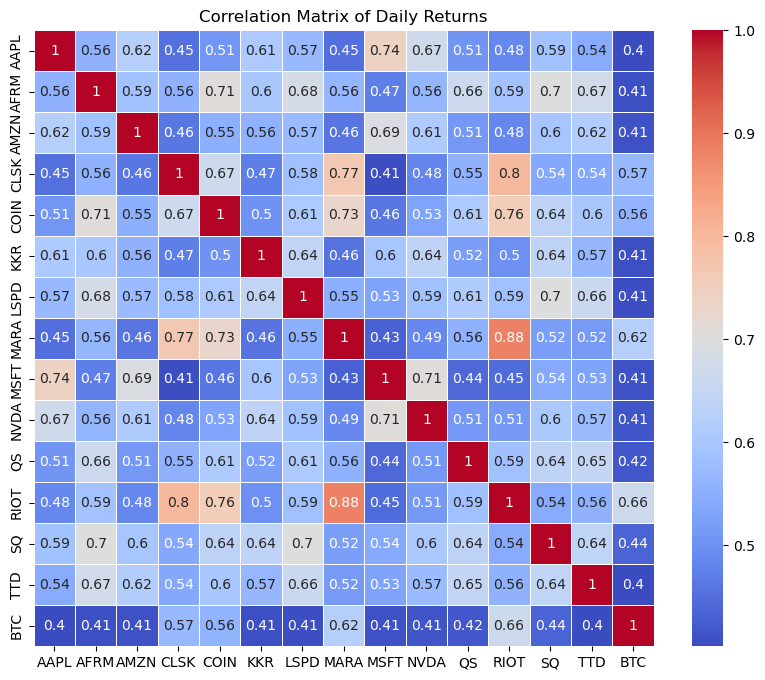

In [24]:
# Create a heatmap for the correlation matrix
plt.figure(figsize = (10, 8))
sns.heatmap(filter_cor_matrix, annot = True, cmap = 'coolwarm', linewidths = .5)
plt.title('Correlation Matrix of Daily Returns')
plt.show()

### 3.2.2 Shift Correlation Analysis

In [25]:
# Shift 2 days for stocks daily return to see if the correlation with BTC will increase

stocks_daily_return = daily_returns[filter_cor_matrix.index].drop(columns = 'BTC')
stocks_daily_return = stocks_daily_return.shift(2)
stocks_daily_return.dropna(inplace = True)
stocks_daily_return.reset_index(drop = True, inplace = True)
stocks_daily_return

,AAPL,AFRM,AMZN,CLSK,COIN,KKR,LSPD,MARA,MSFT,NVDA,QS,RIOT,SQ,TTD
0,-0.012773,-0.108622,-0.017060,0.001042,-0.003591,0.010688,-0.037478,0.037008,-0.017296,-0.027976,-0.010825,0.069638,-0.048080,-0.054154
1,-0.026960,-0.071329,-0.019074,-0.113495,-0.065757,-0.074429,-0.068018,-0.141727,-0.039144,-0.059286,-0.065671,-0.128505,-0.085704,-0.069361
2,-0.016834,0.019549,-0.006734,-0.032012,-0.000982,0.023072,-0.008973,-0.010862,-0.007933,0.020581,-0.035972,-0.045810,0.008121,-0.034621
3,0.000988,-0.018418,-0.004297,-0.019465,-0.007162,-0.015562,-0.004654,-0.028034,0.000510,-0.033598,0.012452,-0.005877,-0.021804,0.025792
4,0.000116,-0.017484,-0.006592,-0.014852,-0.032014,-0.002738,-0.010206,0.015326,0.000732,0.005600,-0.037832,-0.013350,0.020559,0.025761
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
493,-0.010772,-0.103249,-0.010918,0.005736,0.004334,-0.031913,-0.024538,0.005900,-0.007098,-0.030561,-0.073905,-0.013885,-0.015644,-0.028476
494,-0.000770,0.052018,0.011243,0.094530,0.037411,-0.002197,0.050500,0.114459,0.007848,0.018105,0.041731,0.018073,0.010326,0.011986
495,-0.005563,0.023094,-0.002734,0.030745,0.043383,0.000855,0.010995,0.075001,0.002780,-0.003271,-0.036065,0.059676,0.003116,-0.039388
496,-0.002845,0.019779,-0.000065,-0.012696,-0.019740,0.003169,0.023577,0.009316,0.000214,0.009153,0.038786,-0.024482,0.013392,0.002177


In [26]:
# Extract BTC daily return

btc_daily_return = daily_returns['BTC'].to_frame()
btc_daily_return.reset_index(drop = True, inplace = True)
btc_daily_return

,BTC
0,-0.012139
1,-0.052066
2,-0.009410
3,-0.037848
4,0.006317
...,...
495,0.002931
496,-0.034158
497,0.021462
498,-0.018938


In [27]:
# Combine the shifted stocks daily return with BTC daily return, and calculate its correlation

shift_rtn_matrix = pd.concat([stocks_daily_return, btc_daily_return], join = 'inner', axis = 1)
shift_cor_matrix = shift_rtn_matrix.corr()
shift_cor_matrix

,AAPL,AFRM,AMZN,CLSK,COIN,KKR,LSPD,MARA,MSFT,NVDA,QS,RIOT,SQ,TTD,BTC
AAPL,1.000000,0.558332,0.623596,0.454899,0.508185,0.605108,0.570647,0.452416,0.741149,0.669945,0.506672,0.486070,0.587356,0.542287,0.402500
AFRM,0.558332,1.000000,0.588455,0.556750,0.709172,0.599499,0.681682,0.565298,0.473848,0.562033,0.662665,0.591337,0.699417,0.674542,0.407848
AMZN,0.623596,0.588455,1.000000,0.464058,0.551961,0.556538,0.574839,0.460027,0.692202,0.610529,0.509387,0.486086,0.595722,0.615509,0.410733
CLSK,0.454899,0.556750,0.464058,1.000000,0.666735,0.473847,0.589028,0.764624,0.410081,0.485714,0.555173,0.796884,0.539942,0.540853,0.570486
COIN,0.508185,0.709172,0.551961,0.666735,1.000000,0.499953,0.606018,0.731621,0.461198,0.532728,0.610198,0.756916,0.635987,0.599724,0.560466
KKR,0.605108,0.599499,0.556538,0.473847,0.499953,1.000000,0.642912,0.459149,0.596844,0.639892,0.522526,0.500814,0.639801,0.565525,0.407751
LSPD,0.570647,0.681682,0.574839,0.589028,0.606018,0.642912,1.000000,0.556536,0.528403,0.588904,0.611054,0.589696,0.701152,0.659411,0.406775
MARA,0.452416,0.565298,0.460027,0.764624,0.731621,0.459149,0.556536,1.000000,0.434359,0.490547,0.556195,0.882569,0.524129,0.516827,0.625766
MSFT,0.741149,0.473848,0.692202,0.410081,0.461198,0.596844,0.528403,0.434359,1.000000,0.706234,0.440448,0.448735,0.542005,0.530195,0.410271
NVDA,0.669945,0.562033,0.610529,0.485714,0.532728,0.639892,0.588904,0.490547,0.706234,1.000000,0.511654,0.516551,0.603893,0.574264,0.414924


In [28]:
# Check if there is difference for the correlation
# if the correlation after shift is greater than the original, there is a chance BTC would be a leading indicator
filter_cor_matrix < shift_cor_matrix

,AAPL,AFRM,AMZN,CLSK,COIN,KKR,LSPD,MARA,MSFT,NVDA,QS,RIOT,SQ,TTD,BTC
AAPL,False,False,False,True,False,False,True,True,True,True,False,True,False,False,True
AFRM,False,False,False,True,False,False,True,True,True,True,False,True,False,False,False
AMZN,False,False,False,True,False,False,True,True,True,True,False,True,False,False,False
CLSK,True,True,True,False,False,True,True,False,True,True,True,False,True,True,True
COIN,False,False,False,False,False,False,True,True,True,True,False,True,False,False,True
KKR,False,False,False,True,False,False,True,True,True,True,False,True,False,False,True
LSPD,True,True,True,True,True,True,False,True,True,True,True,True,True,True,True
MARA,True,True,True,False,True,True,True,False,True,True,True,False,True,True,True
MSFT,True,True,True,True,True,True,True,True,False,True,True,True,True,True,True
NVDA,True,True,True,True,True,True,True,True,True,False,True,True,True,True,True


In [29]:
# The percent change of correlation
change_cor_matrix = (shift_cor_matrix - filter_cor_matrix) /filter_cor_matrix * 100
change_cor_matrix

,AAPL,AFRM,AMZN,CLSK,COIN,KKR,LSPD,MARA,MSFT,NVDA,QS,RIOT,SQ,TTD,BTC
AAPL,0.000000,-0.020925,-0.011837,0.402886,-0.004754,-0.015264,0.004338,0.517969,0.016577,0.007127,-0.013065,0.292839,-0.016381,-0.007273,0.027457
AFRM,-0.020925,0.000000,-0.022218,0.191466,-0.031374,-0.022605,0.035242,0.309370,0.060240,0.030812,-0.028444,0.130898,-0.029627,-0.014498,-0.010760
AMZN,-0.011837,-0.022218,0.000000,0.350321,-0.004277,-0.018865,0.019519,0.426220,0.023288,0.008653,-0.027668,0.226308,-0.021479,-0.012741,-0.001827
CLSK,0.402886,0.191466,0.350321,0.000000,-0.013724,0.364285,0.736838,-0.326686,0.887915,0.708978,0.180805,-0.228721,0.197324,0.301117,0.379368
COIN,-0.004754,-0.031374,-0.004277,-0.013724,0.000000,-0.023983,0.095319,0.201893,0.160265,0.108156,-0.043468,0.051808,-0.043681,-0.006771,0.046015
KKR,-0.015264,-0.022605,-0.018865,0.364285,-0.023983,0.000000,0.010799,0.467180,0.022136,0.009440,-0.019837,0.258951,-0.017013,-0.010884,0.019130
LSPD,0.004338,0.035242,0.019519,0.736838,0.095319,0.010799,0.000000,0.932443,0.000724,0.015034,0.070592,0.595501,0.038654,0.058191,0.160291
MARA,0.517969,0.309370,0.426220,-0.326686,0.201893,0.467180,0.932443,0.000000,0.970080,0.757484,0.201732,-0.127708,0.272833,0.283147,0.313441
MSFT,0.016577,0.060240,0.023288,0.887915,0.160265,0.022136,0.000724,0.970080,0.000000,0.002709,0.078638,0.646804,0.054881,0.051579,0.096920
NVDA,0.007127,0.030812,0.008653,0.708978,0.108156,0.009440,0.015034,0.757484,0.002709,0.000000,0.033909,0.487175,0.027575,0.020415,0.042800


In [30]:
# Plot the changes of correlation

change_cor_plot = change_cor_matrix['BTC'].hvplot.bar(title = "Changes of Correlation with BTC for Shift 2 Days", 
                                                    xlabel = 'Assets', ylabel = 'Correlation', hover_color = 'orange')
change_cor_plot

:Bars   [index]   (BTC)

## 3.3 Changes of Correlation over time

In [31]:
"""
    Helper function to calculate the correlation with two tickers.

    Args:
        daily_return (DataFrame): A DataFrame contains the tickers' daily returns information
        tickers (list): list of the tickers' names
        rolling_window: rolling days for the correlation
"""
def correlation(daily_return, tickers, rolling_window):
    
    # Generate a correlation matrix between tickers
    cor = daily_return[tickers].rolling(window = rolling_window).corr().dropna()
    
    # Delete Ticker Index, keep Date Index only
    df_filtered = cor.loc[cor.index.get_level_values(1) == tickers[0], :]
    df_filtered.reset_index(level = 1, inplace = True)
    
    # Drop and rename columns
    df_filtered.drop(columns = ['level_1', tickers[0]], inplace = True)
    df_filtered.columns = ['Correlation']
    
    return df_filtered

In [32]:
# Show the correlation between AAPL and BTC over time

btc_riot_corr = correlation(daily_returns, tickers = ['AAPL', 'BTC'], rolling_window = 30)
btc_riot_corr

C:\Users\yjmal\AppData\Local\Temp\ipykernel_57736\4129890523.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered.drop(columns = ['level_1', tickers[0]], inplace = True)


,Correlation
Date,
2022-02-15,0.375923
2022-02-16,0.372142
2022-02-17,0.375473
2022-02-18,0.377451
2022-02-22,0.406253
...,...
2023-12-22,0.193012
2023-12-26,0.198592
2023-12-27,0.168895


In [33]:
# Plot the correlation over time

btc_riot_corr.hvplot(title = 'Correlation Over Time', xlabel = 'Days', ylabel = 'Correlation', width = 800, height = 400)

:Curve   [Date]   (Correlation)

## 3.4 Sharpe Ratio of Assets

In [34]:
#Set the annual interest rate
interest_rate = 0.02

# Construct the portfolio assets
portfolio = filter_cor_matrix.index.tolist()
portfolio.pop() # remove BTC

#Calculate the annual volavility of tickers
daily_vol = daily_returns[portfolio].std() * np.sqrt(252)

#Calculate the Sharpe Ratio of tickers
avg_rtn = daily_returns[portfolio].mean() * 252
sharpe_ratio = (avg_rtn - interest_rate) / daily_vol
sharpe_ratio

AAPL    0.048365
AFRM   -0.311365
AMZN   -0.182702
CLSK    0.048992
COIN   -0.206188
KKR     0.125925
LSPD   -0.488942
MARA   -0.160360
MSFT    0.155640
NVDA    0.413729
QS     -0.762692
RIOT   -0.214147
SQ     -0.551807
TTD    -0.186086
dtype: float64

In [35]:
#Show the plot of Sharpe Ratio
sharpe_ratio.sort_values(ascending = False).hvplot.bar(xlabel = "Tickers", ylabel = "Sharpe Ratio", 
                                                       title = "Sharpe Ratio", hover_color = "orange") 

:Bars   [index]   (0)

## 3.5 Betas of The Assets Compared With BTC

In [36]:
# Calculate covariance of a single portfolio
covariance_assets = daily_returns[filter_cor_matrix.index].cov().loc['BTC']

# Calculate variance of BTC
var_btc = daily_returns['BTC'].var()

# Computing beta
beta = covariance_assets / var_btc
beta.sort_values(ascending = False)

MARA    1.294977
RIOT    1.164897
CLSK    1.028514
BTC     1.000000
COIN    0.977686
AFRM    0.812549
QS      0.601333
SQ      0.553569
LSPD    0.522058
TTD     0.505637
NVDA    0.406979
AMZN    0.307036
KKR     0.293051
MSFT    0.220830
AAPL    0.205133
Name: BTC, dtype: float64

In [37]:
# Plot the beta

beta.hvplot.bar(title = 'Beta of Different Assets with BTC', xlabel = 'Assets', ylabel = 'Beta', hover_color = 'orange')

:Bars   [index]   (BTC)

# 4. Finding the efficient frontier using Monte Carlo simulations

## 4.1 Monte Carlo Simulation 

In [38]:
#Set up the Monte Carlo Model parameters
np.random.seed(42)

n_assets = len(portfolio)

n_portfolios = 10 ** 5

weights = np.random.random(size = (n_portfolios, n_assets))
weights /= np.sum(weights, axis = 1)[:, np.newaxis]

cov_matrix = daily_returns[portfolio].cov() * 252

In [39]:
"""
    Helper function to calculate the portfolio's volatility.

    Args:
        weights (np.array): An array containing the portfolio weights
        cov_matrix (DataFrame): Covariance of tickers in portfolio
"""
def portf_vol(weights, cov_matrix):
    portf_vol = []
    for i in range(len(weights)):
        vol = np.sqrt(np.dot(weights[i].T, np.dot(cov_matrix, weights[i])))
        portf_vol.append(vol)
    portf_vol = np.array(portf_vol)
    return portf_vol

In [40]:
#Calculate the portfolio matrixs
portf_rtns = np.dot(weights, avg_rtn)
portf_vol = portf_vol(weights, cov_matrix)
portf_sharpe_ratio = (portf_rtns - interest_rate) / portf_vol

In [41]:
#Transform to DataFrame
portf_res = pd.DataFrame({'Returns': portf_rtns, 'Volatility': portf_vol, 'Sharpe Ratio': portf_sharpe_ratio})
portf_res

,Returns,Volatility,Sharpe Ratio
0,-0.111952,0.639917,-0.206202
1,-0.147074,0.618407,-0.270168
2,-0.155106,0.547076,-0.320077
3,-0.155066,0.605260,-0.289241
4,-0.124099,0.638647,-0.225632
...,...,...,...
99995,-0.176025,0.611545,-0.320540
99996,-0.140879,0.596969,-0.269493
99997,-0.145791,0.591383,-0.280344
99998,-0.118451,0.614042,-0.225474


## 4.2 Monte Carlo Chart

In [42]:
# Create Tickers DataFrame for Monte Carlo Chart
tickers_df = pd.concat([avg_rtn, daily_vol, sharpe_ratio], axis = 1)
tickers_df.columns = ['Returns', 'Volatility', 'Sharpe Ratio']
tickers_df.index = tickers_df.index.rename('Assets')
tickers_df

,Returns,Volatility,Sharpe Ratio
Assets,,,
AAPL,0.034046,0.290417,0.048365
AFRM,-0.333351,1.134847,-0.311365
AMZN,-0.057803,0.425848,-0.182702
CLSK,0.070509,1.030963,0.048992
COIN,-0.184997,0.994221,-0.206188
KKR,0.071568,0.409509,0.125925
LSPD,-0.338055,0.732307,-0.488942
MARA,-0.169643,1.182613,-0.160360
MSFT,0.067771,0.306931,0.155640


In [43]:
# Tickers Scatter Chart
tickers_plot = tickers_df.hvplot.scatter(x = 'Volatility', y = 'Returns', c = "Sharpe Ratio", 
                                         legend = 'top', height = 400, width = 800, by = 'Assets')
tickers_plot

:NdOverlay   [Assets]
   :Scatter   [Volatility]   (Returns,Sharpe Ratio)

In [44]:
# Simulation Portfolio Scatter Chart
portf_plot = portf_res.hvplot.scatter(x = 'Volatility', y = 'Returns', c = "Sharpe Ratio", 
                                      height = 400, width = 800, title = 'Monte Carlo Simulation')
portf_plot

:Scatter   [Volatility]   (Returns,Sharpe Ratio)

In [45]:
# Find out the points on the efficient frontier curve
ef_rtn = []
ef_vol = []
possible_ef_rtns = np.linspace(portf_res['Returns'].min(), portf_res['Returns'].max(), 1000)


possible_ef_rtns = np.round(possible_ef_rtns, 3)
round_rtns = np.round(portf_rtns, 3)

for rtn in possible_ef_rtns:
    if rtn in round_rtns:
        ef_rtn.append(rtn)
        matched_ind = np.where(round_rtns == rtn)
        ef_vol.append(np.min(portf_vol[matched_ind]))

In [46]:
# Plot the efficient frontier curve
ef_df = pd.DataFrame({'Returns': ef_rtn, 'Volatility': ef_vol})
ef_plot = ef_df.hvplot.scatter(x = 'Volatility', y = 'Returns', title = 'Effecient Frointer')
ef_plot

:Scatter   [Volatility]   (Returns)

In [47]:
# Combine the charts
(tickers_plot * portf_plot * ef_plot).opts(height = 400, width = 900)

:Overlay
   .NdOverlay.I :NdOverlay   [Assets]
      :Scatter   [Volatility]   (Returns,Sharpe Ratio)
   .Scatter.I   :Scatter   [Volatility]   (Returns,Sharpe Ratio)
   .Scatter.II  :Scatter   [Volatility]   (Returns)

## 4.3 Show the highest Sharpe Ratio Portfolio

In [48]:
"""
    Helper function for printing the performance summary of a portfolio.

    Args:
        perf (pd.Series): Series containing the perf metrics
        weights (np.array): An array containing the portfolio weights
        assets (list): list of the asset names
        name (str): the name of the portfolio
"""

def print_portfolio_summary(perf, weights, assets, name):
    print(f"{name} portfolio ----")
    print("\nPerformance")
    for index, value in perf.items():
        print(f"{index}: {100 * value:.2f}% ", end = "", flush = True)
    print("\n\nWeights")
    for x, y in zip(assets, weights):
        print(f"{x}: {100 * y:.2f}% ", end = "\n", flush = True)
    print('Total weigths: ', 100 * weights.sum())

In [49]:
#Extract the max_sharpe_ratio
max_sharpe_ind = np.argmax(portf_res['Sharpe Ratio'])
max_sharpe_portf = portf_res.loc[max_sharpe_ind]

In [50]:
# Show what is the optimized portfolio

print_portfolio_summary(max_sharpe_portf, weights[max_sharpe_ind], portfolio, name = "Maximum Sharpe Ratio")

Maximum Sharpe Ratio portfolio ----

Performance
Returns: 1.97% Volatility: 53.09% Sharpe Ratio: -0.05% 

Weights
AAPL: 18.47% 
AFRM: 0.88% 
AMZN: 0.01% 
CLSK: 21.23% 
COIN: 0.06% 
KKR: 6.57% 
LSPD: 3.22% 
MARA: 1.21% 
MSFT: 1.83% 
NVDA: 23.39% 
QS: 2.17% 
RIOT: 3.76% 
SQ: 3.86% 
TTD: 13.33% 
Total weigths:  100.00000000000003


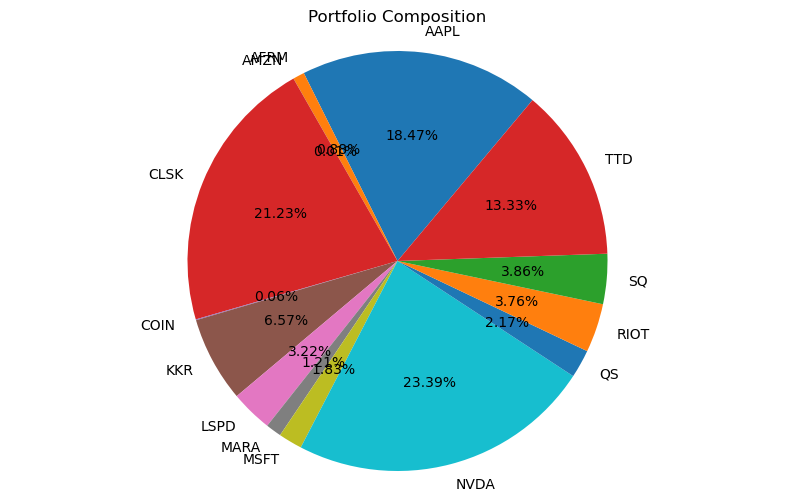

In [51]:
# Show Pie Chart for the optimized portfolio

data = zip(portfolio, weights[max_sharpe_ind])

# Unpack the zipped data into separate lists
labels, values = zip(*data)

# Create a pie chart
fig, ax = plt.subplots(figsize = (10, 6))
ax.pie(values, labels = labels, autopct = '%1.2f%%', startangle = 50)
ax.axis('equal')  # Equal aspect ratio ensures that the pie is drawn as a circle.

plt.title('Portfolio Composition')
plt.show()

# 5. Comparison with Portfolio and BTC

In [52]:
# Create a optimized portfolio from the result of Monte Carlo Simulation

portfolio_rtn = daily_returns[portfolio] * weights[max_sharpe_ind]
portfolio_rtn['Portfolio'] = portfolio_rtn.sum(axis = 1)
cum_port_rtn = portfolio_rtn['Portfolio'].cumsum().apply(np.exp)
cum_port_rtn

Date
2022-01-04    0.983429
2022-01-05    0.915165
2022-01-06    0.905355
2022-01-07    0.895602
2022-01-10    0.896136
                ...   
2023-12-22    1.062260
2023-12-26    1.063211
2023-12-27    1.102509
2023-12-28    1.093517
2023-12-29    1.039909
Name: Portfolio, Length: 500, dtype: float64

In [53]:
# Plot the cumulative return of portfolio

port_plot = cum_port_rtn.hvplot(title = 'Cumulative Return of Constructed Portfolio', 
                                xlabel = 'Date', ylabel = 'Cumulative Return')
port_plot

:Curve   [Date]   (Portfolio)

In [54]:
# Calculate BTC cumulative return using log method

btc_cum_rtn = daily_returns['BTC'].cumsum().apply(np.exp)
btc_cum_rtn

Date
2022-01-04    0.987934
2022-01-05    0.937813
2022-01-06    0.929029
2022-01-07    0.894524
2022-01-10    0.900193
                ...   
2023-12-22    0.947044
2023-12-26    0.915242
2023-12-27    0.935097
2023-12-28    0.917555
2023-12-29    0.906180
Name: BTC, Length: 500, dtype: float64

In [55]:
# Plot the cumulative return of BTC

btc_plot = btc_cum_rtn.hvplot(title = 'Cumulative Return of BTC', xlabel = 'Date', ylabel = 'Cumulative Return')
btc_plot

:Curve   [Date]   (BTC)

In [56]:
# Combined the plots to show comparison with portfolio and BTC

(port_plot * btc_plot).opts(title = 'Comparison with Portfolio and BTC')

:Overlay
   .Curve.Portfolio :Curve   [Date]   (Portfolio)
   .Curve.BTC       :Curve   [Date]   (BTC)

# 6. Backtesing Trading Strategy

## 6.1 Trading strategy 1 rules:
* When portfolio price is above its SMA 20 moving average curve, long the position
* When portfolio price is lower its SMA 20 moving average curve, close the position

In [57]:
# Get the portfolio's close price

portfolio_prices = stocks_close[portfolio] * weights[max_sharpe_ind]
portfolio_prices['Portfolio'] = portfolio_prices.sum(axis = 1)

In [58]:
# Create the SMA 20 curve data

portfolio_prices['sma_20'] = portfolio_prices['Portfolio'].rolling(window = 20).mean()
portfolio_prices['sma_20']

Date
2022-01-03           NaN
2022-01-04           NaN
2022-01-05           NaN
2022-01-06           NaN
2022-01-07           NaN
                 ...    
2023-12-22    175.525393
2023-12-26    175.885217
2023-12-27    176.315910
2023-12-28    176.698114
2023-12-29    177.181494
Name: sma_20, Length: 501, dtype: float64

In [59]:
# Create trading signal as position

portfolio_prices['position'] = (portfolio_prices['Portfolio'] > portfolio_prices['sma_20']).astype(int)
portfolio_prices['position']

Date
2022-01-03    0
2022-01-04    0
2022-01-05    0
2022-01-06    0
2022-01-07    0
             ..
2023-12-22    1
2023-12-26    1
2023-12-27    1
2023-12-28    1
2023-12-29    1
Name: position, Length: 501, dtype: int32

In [60]:
# Show how many times the portfolio trades over time

sum((portfolio_prices['position'] == 1) & (portfolio_prices['position'].shift(1) == 0))

27

In [61]:
# Show the comparison with portfolio and SMA 20 curve

portfolio_prices[['Portfolio', 'sma_20']].hvplot()

:NdOverlay   [Ticker]
   :Curve   [Date]   (value)

In [62]:
# Calculate the strategy return

portfolio_prices['strategy_1_rtn'] = portfolio_prices['position'].shift(1) * portfolio_rtn['Portfolio']
portfolio_prices['strategy_1_rtn']

Date
2022-01-03         NaN
2022-01-04   -0.000000
2022-01-05   -0.000000
2022-01-06   -0.000000
2022-01-07   -0.000000
                ...   
2023-12-22    0.002663
2023-12-26    0.000895
2023-12-27    0.036295
2023-12-28   -0.008190
2023-12-29   -0.050266
Name: strategy_1_rtn, Length: 501, dtype: float64

In [63]:
# Calculate the cumulative return of the strategy

portfolio_prices['strategy_1_cum_rtn'] = portfolio_prices['strategy_1_rtn'].cumsum().apply(np.exp)

In [64]:
# Plot the cumulative return of strategy

strategy_1_plot = portfolio_prices['strategy_1_cum_rtn'].hvplot(ylabel = 'Cumulative Return', 
                                                            title = 'Cumulative Strategy Return')
strategy_1_plot

:Curve   [Date]   (strategy_1_cum_rtn)

In [65]:
#Combine the plots of portfolio, BTC and strategy return

(port_plot * btc_plot * strategy_1_plot).opts(title = 'Comparison with Portfolio, BTC and Strategy Return', 
                                            width = 900, height = 400, legend_position = 'top_left')

:Overlay
   .Curve.Portfolio          :Curve   [Date]   (Portfolio)
   .Curve.BTC                :Curve   [Date]   (BTC)
   .Curve.Strategy_1_cum_rtn :Curve   [Date]   (strategy_1_cum_rtn)

## 6.2 Trading strategy rules: (BTC is the leading indicator)
* When BTC price is above its SMA 20 moving average curve, long the position
* When BTC price is lower its SMA 20 moving average curve, close the position

In [66]:
# Create the BTC SMA 20 curve data

btc_close['sma_20'] = btc_close.rolling(window = 20).mean()
btc_close['sma_20']

Date
2022-01-01             NaN
2022-01-02             NaN
2022-01-03             NaN
2022-01-04             NaN
2022-01-05             NaN
                  ...     
2023-12-26    42920.541602
2023-12-27    42928.051172
2023-12-28    42851.113867
2023-12-29    42769.784766
2023-12-30    42688.644922
Name: sma_20, Length: 729, dtype: float64

In [67]:
# Create trading signal as position

portfolio_prices['position_btc_leading'] = (btc_close['BTC'] > btc_close['sma_20']).astype(int)
portfolio_prices['position_btc_leading']

Date
2022-01-03    0
2022-01-04    0
2022-01-05    0
2022-01-06    0
2022-01-07    0
             ..
2023-12-22    1
2023-12-26    0
2023-12-27    1
2023-12-28    0
2023-12-29    0
Name: position_btc_leading, Length: 501, dtype: int32

In [68]:
# Show how many times the portfolio trades over time

sum((portfolio_prices['position_btc_leading'] == 1) & (portfolio_prices['position_btc_leading'].shift(1) == 0))

39

In [69]:
# Calculate the strategy return

portfolio_prices['strategy_2_rtn'] = portfolio_prices['position_btc_leading'].shift(1) * portfolio_rtn['Portfolio']
portfolio_prices['strategy_2_rtn']

Date
2022-01-03         NaN
2022-01-04   -0.000000
2022-01-05   -0.000000
2022-01-06   -0.000000
2022-01-07   -0.000000
                ...   
2023-12-22    0.002663
2023-12-26    0.000895
2023-12-27    0.000000
2023-12-28   -0.008190
2023-12-29   -0.000000
Name: strategy_2_rtn, Length: 501, dtype: float64

In [70]:
# Calculate the cumulative return of the strategy

portfolio_prices['strategy_2_cum_rtn'] = portfolio_prices['strategy_2_rtn'].cumsum().apply(np.exp)

In [71]:
# Plot the cumulative return of strategy

strategy_2_plot = portfolio_prices['strategy_2_cum_rtn'].hvplot(ylabel = 'Cumulative Return', 
                                                            title = 'Cumulative Strategy Return')
strategy_2_plot

:Curve   [Date]   (strategy_2_cum_rtn)

In [72]:
#Combine the plots of portfolio, BTC and strategys return

(port_plot * btc_plot * strategy_1_plot * strategy_2_plot).opts(title = 'Comparison with Portfolio, BTC and Strategys Return', 
                                                                 width = 900, height = 400, legend_position = 'top_left')

:Overlay
   .Curve.Portfolio          :Curve   [Date]   (Portfolio)
   .Curve.BTC                :Curve   [Date]   (BTC)
   .Curve.Strategy_1_cum_rtn :Curve   [Date]   (strategy_1_cum_rtn)
   .Curve.Strategy_2_cum_rtn :Curve   [Date]   (strategy_2_cum_rtn)